# Ciclo de Carnot


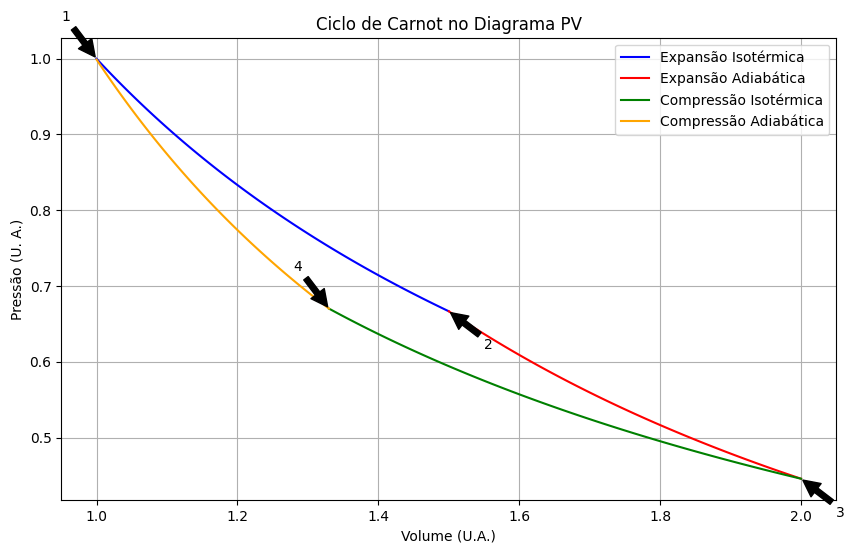

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Valor de gama, o coeficiente de expansão adiabática. Ele exprime a razão entre a capacidade térmica
# a pressão constante (Cp) e a capacidade térmica a volume constante (Cv), para um gás ideal.
# gamma = Cp/Cv = 1.4 para o ar a 20ºC (gás diatômico ideal) .
gamma = 1.4

# Vamos escolher quatro valores diferentes de volume de gás para calcular as trajetórias dos processos.
# O Ponto 1 = (P1, V1) do diagrama PV define o início do ciclo.
# Os valores e as unidades adotados são arbitrários e faremos nR = 1, por simplicidade.
V1 = 1.0
V2 = 1.5
V3 = 2.0
V4 = 1.33

# Ponto 1: Início do primeiro processo - expansão isotérmica do gás. Vamos usar a equação
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade. Logo: PV = T.
P1 = 1.0  # Pressão no Ponto 1 do Diagrama PV.
T1 = P1 * V1  # Temperatura no Ponto 1 do Diagrama PV.
# Ponto 2: Final do primeiro processo - expansão isotérmica do gás.
# Temperatura no Ponto 2 do Diagrama PV é a mesma que a do Ponto 1. Essa temperatura deve
# ser a mesma que aquela do Ponto 1, pois ocorreu uma expansão isotérmica.
T2 = T1
# Gerando os pontos para a curva que representa a expansão isotérmica do gás.
V_exp_isotermica = np.linspace(V1, V2, 100)
P_exp_isotermica = T1 / V_exp_isotermica

# Ponto 2: Início do segundo processo - expansão adiabática do gás.
# No Ponto 2 do ciclo, o volume do gás é V2. Logo, a pressão no Ponto 2 do Diagrama PV será:
P2 = T2 / V2
# Ponto 3: Final do segundo processo - expansão adiabática do gás.
# Para um processo adiabático, P*V^gamma = constante, então P3*V3^gamma = P2*V2^gamma.
# Podemos encontrar o valor da pressão P3 usando os valores dos volumes V2 e V3, conhecendo P2.
P3 = P2 * (V2 ** gamma) / (V3 ** gamma)
# Gerando os pontos para a curva que representa a expansão adiabática do gás.
V_exp_adiabatica = np.linspace(V2, V3, 100)
P_exp_adiabatica = P2 * (V2 ** gamma) / (V_exp_adiabatica ** gamma)

# Ponto 3: Início do terceiro Processo - compressão isotérmica do gás. Usamos a equação
# de estado dos gases ideais: PV = nRT, com nR = 1, por simplicidade.
# No ponto 3 do ciclo, a pressão do gás é P3 e o volume é V3. Logo, a temperatura será:
T3 = P3 * V3
# Gerando os pontos para a curva que representa a compressão isotérmica do gás.
V_comp_isotermica = np.linspace(V3, V4, 100)
P_comp_isotermica = T3 / V_comp_isotermica

# Ponto 4: Início do quarto Processo - compressão adiabática do gás.
# Temperatura no Ponto 4 do Diagrama PV é a mesma que a do Ponto 3. Essa temperatura deve
# ser a mesma que aquela do Ponto 3, pois ocorreu uma compressão isotérmica.
T4 = T3
# Pressão no Ponto 4 do diagrama PV. Usamos a equação de estado dos gases ideais: PV = nRT,
# com nR = 1, por simplicidade. Isto porque o processo 3->4 é uma compressão isotérmica.
P4 = T4 / V4
# Voltando ao Ponto 1: Final do ciclo.
# Para um processo adiabático, P*V^gamma = constante, então P1*V1^gamma = P4*V4^gamma.
# Podemos encontrar o valor da pressão no Ponto 1 usando os valores dos volumes V1 e V4, conhecendo P4.
# Gerando os pontos para a curva que representa a compressão adiabática do gás.
V_comp_adiabatica = np.linspace(V4, V1, 100)
P_comp_adiabatica = P4 * (V4 ** gamma) / (V_comp_adiabatica ** gamma)

# Plotagem do diagrama PV.
plt.figure(figsize = (10, 6))
plt.plot(V_exp_isotermica, P_exp_isotermica, 'b', label = 'Expansão Isotérmica')
plt.plot(V_exp_adiabatica, P_exp_adiabatica, 'r', label = 'Expansão Adiabática')
plt.plot(V_comp_isotermica, P_comp_isotermica, 'g', label = 'Compressão Isotérmica')
plt.plot(V_comp_adiabatica, P_comp_adiabatica, 'orange', label = 'Compressão Adiabática')
plt.xlabel('Volume (U.A.)')
plt.ylabel('Pressão (U. A.)')
plt.title('Ciclo de Carnot no Diagrama PV')
plt.legend()
plt.grid(True)
# Setas indicando os inícios dos processos do ciclo.
plt.annotate('1', xy = (V1, P1), xytext = (V1 - 0.05, P1 + 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('2', xy = (V2, P2), xytext = (V2 + 0.05, P2 - 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('3', xy = (V3, P3), xytext = (V3 + 0.05, P3 - 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.annotate('4', xy = (V4, P4), xytext = (V4 - 0.05, P4 + 0.05), arrowprops = dict(facecolor = 'black', shrink = 0.05))
plt.show()

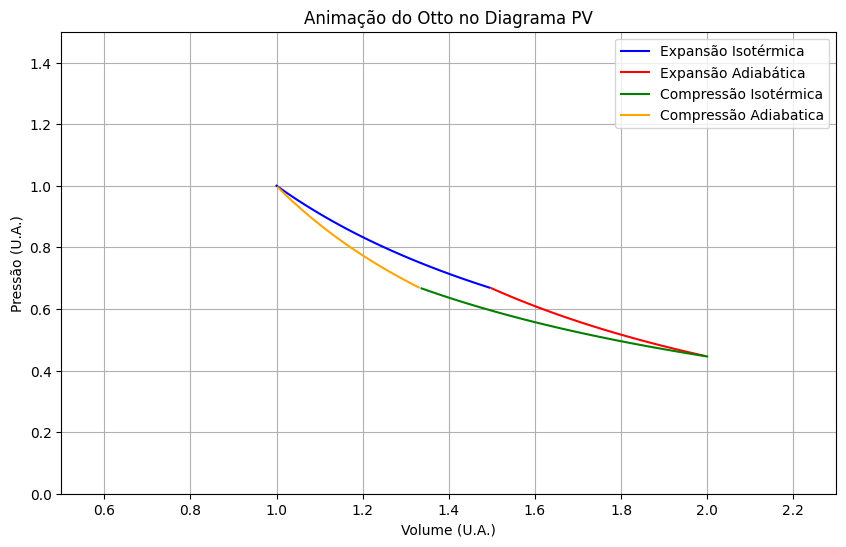

In [2]:
plt.rcParams['animation.embed_limit'] = 256
fig, ax = plt.subplots(figsize=(10, 6))
ax.set_ylim(0, 1.5)
ax.set_xlim(0.5, 2.3)
ax.set_xlabel('Volume (U.A.)')
ax.set_ylabel('Pressão (U.A.)')
ax.set_title('Animação do Otto no Diagrama PV')

# Inicializando as curvas como linhas vazias
line_exp_isotermica, = ax.plot([], [], 'b', label='Expansão Isotérmica')
line_exp_adiabatica, = ax.plot([], [], 'r', label='Expansão Adiabática')
line_comp_isotermica, = ax.plot([], [], 'g', label='Compressão Isotérmica')
line_comp_adiabatica, = ax.plot([], [], 'orange', label='Compressão Adiabatica')

# Adicionando a legenda e a grade
ax.legend()
ax.grid(True)

# Função de inicialização, chamada apenas uma vez
def init():
    line_exp_isotermica.set_data([], [])
    line_exp_adiabatica.set_data([], [])
    line_comp_isotermica.set_data([], [])
    line_comp_adiabatica.set_data([], [])
    return line_exp_isotermica, line_exp_adiabatica, line_comp_isotermica, line_comp_adiabatica

# Função de animação
def animate(frame):
    # Atualizando os dados das curvas
    if frame < len(V_exp_isotermica):
        line_exp_isotermica.set_data(V_exp_isotermica[:frame], P_exp_isotermica[:frame])
    elif frame < len(V_exp_isotermica) + len(V_exp_adiabatica):
        line_exp_adiabatica.set_data(V_exp_adiabatica[:frame-len(V_exp_isotermica)], P_exp_adiabatica[:frame-len(V_exp_isotermica)])
    elif frame < len(V_exp_isotermica) + len(V_exp_adiabatica) + len(V_comp_isotermica):
        line_comp_isotermica.set_data(V_comp_isotermica[:frame-(len(V_exp_isotermica)+len(V_exp_adiabatica))], P_comp_isotermica[:frame-(len(V_exp_isotermica)+len(V_exp_adiabatica))])
    else:
        line_comp_adiabatica.set_data(V_comp_adiabatica[:frame-(len(V_exp_isotermica)+len(V_exp_adiabatica)+len(V_comp_isotermica))], P_comp_adiabatica[:frame-(len(V_exp_isotermica)+len(V_exp_adiabatica)+len(V_comp_isotermica))])

    return line_exp_isotermica, line_exp_adiabatica, line_comp_isotermica, line_comp_adiabatica


# Configurando a animação
total_frames = len(V_exp_isotermica) + len(V_exp_adiabatica) + len(V_comp_isotermica) + len(V_comp_adiabatica)
ani = FuncAnimation(fig, animate, frames=total_frames, init_func=init, blit=True, interval=100)

# Exibindo a animação usando JSAnimation
HTML(ani.to_jshtml())
# ani.save('ciclo_carnot_animacao.gif', writer='imagemagick', fps=40)
